In [5]:
from typing import Iterable
import re

from sklearn.feature_extraction.text import CountVectorizer
from unidecode import unidecode
from wordcloud import WordCloud
import pandas as pd
import numpy as np
import gdown  # libreria para descargar archivos grandes desde Google Drive
import spacy

import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

pd.set_option("display.max_columns", 500)  # Mostrar mas columnas de un DataFrame
pd.set_option("plotting.backend", "plotly")
sns.set(style="darkgrid")

nlp = spacy.load("en_core_web_sm")

In [7]:
def load_data(download_data: bool = False) -> pd.DataFrame:
    file_id = "1D31Z6sUCVUynRyimxs2n8rrULnlwhP9l"
    url = f"https://drive.google.com/uc?id={file_id}"
    output = "data/jigsaw_data.zip"
    if download_data:
        gdown.download(url, output)

    df = pd.read_csv(output, dtype=str)
    print(f"El dataset tiene {df.shape[0]} filas y {df.shape[1]} columnas.")
    return df


def preprocess_df(df: pd.DataFrame) -> pd.DataFrame:
    df["toxicity"] = pd.to_numeric(df["toxicity"])
    df["len_text"] = df["comment_text"].str.len()
    return df


def sample_from_total_comments(df: pd.DataFrame, n: int = 5_000) -> pd.DataFrame:
    return df.query("split=='test'").sample(n, random_state=42)

In [41]:
comments_total = load_data(download_data=False)
comments_total.head(3)

El dataset tiene 1999516 filas y 46 columnas.


,id,comment_text,split,created_date,publication_id,parent_id,article_id,rating,funny,wow,sad,likes,disagree,toxicity,severe_toxicity,obscene,sexual_explicit,identity_attack,insult,threat,male,female,transgender,other_gender,heterosexual,homosexual_gay_or_lesbian,bisexual,other_sexual_orientation,christian,jewish,muslim,hindu,buddhist,atheist,other_religion,black,white,asian,latino,other_race_or_ethnicity,physical_disability,intellectual_or_learning_disability,psychiatric_or_mental_illness,other_disability,identity_annotator_count,toxicity_annotator_count
0,1083994,He got his money... now he lies in wait till a...,train,2017-03-06 15:21:53.675241+00,21,NaN,317120,approved,0,0,0,2,0,0.373134328358209,0.04477611940298507,0.08955223880597014,0.01492537313432836,0.0,0.34328358208955223,0.01492537313432836,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,67
1,650904,Mad dog will surely put the liberals in mental...,train,2016-12-02 16:44:21.329535+00,21,NaN,154086,approved,0,0,1,2,0,0.6052631578947368,0.013157894736842105,0.06578947368421052,0.013157894736842105,0.09210526315789473,0.5657894736842105,0.06578947368421052,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,76
2,5902188,And Trump continues his lifelong cowardice by ...,train,2017-09-05 19:05:32.341360+00,55,NaN,374342,approved,1,0,2,3,7,0.6666666666666666,0.015873015873015872,0.031746031746031744,0.0,0.047619047619047616,0.6666666666666666,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,63


In [69]:
comments = sample_from_total_comments(comments_total)
comments = preprocess_df(comments)

In [37]:
fig = px.histogram(
    comments_total,
    x="toxicity",
    title="Toxicity distribution",
    opacity=0.6,
    log_y=True,
    nbins=200,
)
fig.update_layout(xaxis_title="Toxicity", yaxis_title="Count", template="seaborn")
fig.show()

In [40]:
fig = px.histogram(comments, x="len_text", title="Comment length dist.", opacity=0.8)
fig.update_layout(xaxis_title="Toxicity", yaxis_title="Count", template="seaborn")
fig.show()
comments["len_text"].describe()

count    5000.000000
mean      292.108600
std       266.700575
min         1.000000
25%        92.000000
50%       197.000000
75%       408.250000
max      1000.000000
Name: len_text, dtype: float64

In [47]:
def get_bow(corpus: Iterable) -> tuple[np.ndarray, CountVectorizer]:
    vect = CountVectorizer(max_features=1000).fit(corpus)
    X = vect.transform(corpus).toarray()
    return X, vect


def get_wordcloud(X: np.ndarray, vect: CountVectorizer) -> WordCloud:
    vocab = vect.get_feature_names_out()
    count_dict = dict(zip(vocab, X.sum(axis=0)))
    # count_dict: dict[str, int] = pd.DataFrame(X, columns=vocab).sum().to_dict()
    wc = WordCloud(width=800, height=400, background_color="white")
    wc.generate_from_frequencies(count_dict)
    return wc

In [50]:
# alias para los tipos de spacy
SpacyToken = spacy.tokens.Token
SpacyDoc = spacy.tokens.Doc
SpacyPipe = spacy.language.Language


# funciones de procesamiento de texto
def to_spacy(corpus: Iterable, nlp: SpacyPipe) -> list[SpacyDoc]:
    """Convert text to spacy doc"""
    return list(nlp.pipe(corpus, n_process=1))


def filter_stopwords(doc: SpacyDoc) -> Iterable[SpacyToken]:
    """Remove stopwords"""
    return filter(lambda token: not token.is_stop, doc)


def filter_by_len(doc: Iterable, len_min: int | None = 2) -> Iterable[SpacyToken]:
    """Filter by length"""
    return filter(lambda token: len(token) >= len_min, doc)


def lemmatize(doc: SpacyDoc) -> Iterable[str]:
    """Lemmatize text"""
    return filter(lambda token: token.lemma_, doc)


def get_text_from_doc(doc: SpacyDoc) -> str:
    """Get text from spacy doc"""
    return " ".join(token.text for token in doc)


def normalize(text: str) -> str:
    """Convert to lowercase and remove accents"""
    return unidecode(text).lower()


def remove_nonalpha(text: str) -> str:
    """Remove non-alphabetic characters"""
    return re.sub(r"[^a-z ]", "", text)


def remove_doublespaces(text: str) -> str:
    """Remove extra whitespaces"""
    return " ".join(text.split())


def preprocess(text: str, nlp: SpacyPipe, lemma: bool = True) -> str:
    """Preprocess text"""
    doc = nlp(text)
    doc_filter = filter_stopwords(doc)
    doc_filter = filter_by_len(doc_filter, 3)
    doc_filter = lemmatize(doc_filter) if lemma else doc_filter
    text_prep = get_text_from_doc(doc_filter)
    text_prep = normalize(text_prep)
    text_prep = remove_nonalpha(text_prep)
    text_prep = remove_doublespaces(text_prep)
    return text_prep

In [68]:
def drop_missing_comments(df):
    return df[df["comment_text"].notna()]


def drop_short_comments(df, min_len=4):
    return df[df["comment_text"].str.len() > min_len]



,id,comment_text,split,created_date,publication_id,parent_id,article_id,rating,funny,wow,sad,likes,disagree,toxicity,severe_toxicity,obscene,sexual_explicit,identity_attack,insult,threat,male,female,transgender,other_gender,heterosexual,homosexual_gay_or_lesbian,bisexual,other_sexual_orientation,christian,jewish,muslim,hindu,buddhist,atheist,other_religion,black,white,asian,latino,other_race_or_ethnicity,physical_disability,intellectual_or_learning_disability,psychiatric_or_mental_illness,other_disability,identity_annotator_count,toxicity_annotator_count,comment_text_prep
1027656,7012309,Hardly a civil comment and quite distressing t...,test,2017-04-25 13:15:28.130196+00,53,5175363.0,328777,approved,0,0,0,0,0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,4,hardly civil comment distressing poster feels ...
1751051,7111891,Vilifying the person does nothing to solve the...,test,2016-06-29 21:53:28.194337+00,21,369137.0,140322,approved,0,0,0,1,0,0.300000,0.0,0.0,0.0,0.1,0.3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,4,10,vilifying person solve root problem demonstrat...
1839572,7141408,That Pope Francis would consider meeting with ...,test,2017-04-20 05:18:58.637117+00,53,NaN,328136,approved,0,0,0,1,0,0.400000,0.0,0.0,0.1,0.2,0.3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4,10,pope francis consider meeting man appalling in...
767016,7053468,HI:Good to hear from you!!(and yes it was wort...,test,2017-01-26 16:03:13.562060+00,54,900688.0,164205,approved,0,0,0,4,0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,4,good hear youand yes worth people suits think ...
1811958,7147900,Millenials are not going go along with someone...,test,2017-06-23 08:48:48.586771+00,53,NaN,347685,approved,0,0,0,36,2,0.166667,0.0,0.0,0.0,0.0,0.16666666666666666,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,6,millenials going telling believe unfortunately...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1008923,7159297,"Yup, I'm trying by the hour and day! Solar is...",test,2017-10-05 23:19:42.889562+00,54,6088821.0,385595,approved,0,0,0,3,1,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,4,yup trying hour day solar ontario httpswwwcnss...
1993607,7003840,OMG. Good job on those who reported the abuse...,test,2016-02-09 00:15:52.445137+00,13,NaN,37008,approved,0,0,0,1,0,0.200000,0.0,0.0,0.0,0.0,0.2,0.0,0.6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.1,0.0,0.0,0.5,0.0,10,5,omg good job reported abuse epd quick action g...
1476784,7177133,There is also a vast difference between knowle...,test,2017-04-25 15:44:55.911567+00,53,5176850.0,328923,approved,0,0,0,1,0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10,4,vast difference knowledge truth perceived know...
1216978,7102559,Vetting under Obama was stringent. GOP is blow...,test,2017-02-23 04:25:12.986884+00,53,1032846.0,169235,approved,0,0,0,0,0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,4,vetting obama stringent gop blowing smoke way ...


In [ ]:
def plot_wordcloud(X, vect) -> None:
    """Plot wordcloud from bag of words matrix"""
    wc = get_wordcloud(X, vect)
    _fig, ax = plt.subplots()
    ax.imshow(wc)
    ax.axis("off")

In [51]:
comments.pipe(drop_missing_comments).pipe(drop_short_comments)
comments["comment_text_prep"] = comments["comment_text"].apply(preprocess, nlp=nlp)

# obtenter bag of words
X, vect = get_bow(comments.query("toxicity > 0.7")["comment_text_prep"])
plot_wordcloud(X, vect)

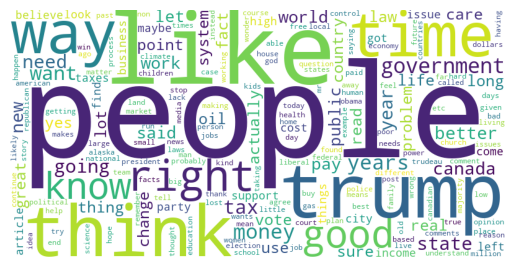

In [58]:
X, vect = get_bow(comments.query("toxicity < 0.1")["comment_text_prep"])
plot_wordcloud(X, vect)